In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import librosa
import librosa.display
import soundfile
import random
from IPython.display import display, Audio

In [2]:
t = np.arange(0, 16, 1/100)

In [3]:
sig = np.sin(t)

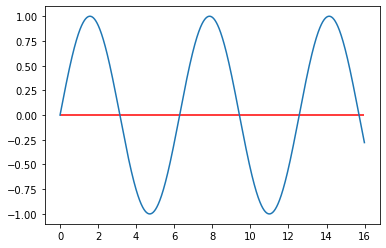

In [4]:
plt.plot(t, sig)
plt.hlines(0, min(t), max(t), colors='r');

In [5]:
# np.sign reduces a number to its sign
# we shift the signal by 1 and see where sign transitions
# which gives us the crossig
crossings = np.where(np.sign(sig[:-1]) < (np.sign(sig[1:])))[0]
crossings

array([   0,  628, 1256])

In [6]:
# optional splitting of signal at crossings from negative to non-negative
np.split(sig, crossings);

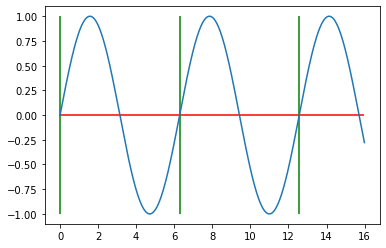

In [7]:
plt.plot(t, sig)
plt.hlines(0, min(t), max(t), colors='r')
# scale crossings to time resolution
plt.vlines(crossings/100, min(sig), max(sig), colors='g');

In [8]:
def separate_wavesets(array, min_length):
    # np.empty or np.zeroes - aber das kann nicht gut wachsen wegen
    # der C bibliothek im hintergrund
    chunks = np.array(0) # soll eigentlich leer sein, "geht aber nicht"
    prev_val = np.array(0.)  # warum als array?
    current_chunk = np.array(prev_val)  # s.o.
    chunk_length = 1
    for i in range(1, len(array)):
        val = array[i]  # use foreach loop instead of iterating over indices
        if (prev_val < 0. and val >= 0 and chunk_length >= min_length):
            # only checks for one crossing
            np.append(chunks, current_chunk)
            current_chunk = []
            chunk_length = 0
        np.append(current_chunk, val)  # this is really heavy on the performance
        chunk_length = chunk_length + 1
        prev_val = val
    np.append(chunks, current_chunk)
    return chunks

# Finding wavesets in a sound file

In [9]:
path = 'violin.flac'
data, sr = librosa.load(path, sr=44100, mono=True)
display(Audio(path))

In [23]:
def wavesets_breakpoints(array: np.ndarray, min_length: int):
    indices = [0]
    prev_item = array[0]
    for i, item in enumerate(array):
        if ((item > 0.0 and prev_item <= 0.0) and (i-indices[-1] >= min_length)) :
            indices.append(i)
        prev_item = item
    return indices
def separate_wavesets(array: np.ndarray, min_length: int):
    ws = np.split(array, wavesets_breakpoints(array, min_length))
    ws.pop(0) # we ignore the first
    return ws

In [49]:
wavesets_data = separate_wavesets(data, 128)

In [50]:
wavesets_data[1]

array([ 1.6326904e-03,  3.0364990e-03,  4.3487549e-03,  5.5694580e-03,
        6.1340332e-03,  6.4086914e-03,  6.8206787e-03,  7.2326660e-03,
        6.9732666e-03,  5.8135986e-03,  4.3182373e-03,  2.7618408e-03,
        6.4086914e-04, -1.6326904e-03, -3.6468506e-03, -5.0506592e-03,
       -5.9509277e-03, -6.5612793e-03, -6.5460205e-03, -5.7830811e-03,
       -4.6234131e-03, -3.2806396e-03, -2.6550293e-03, -2.4871826e-03,
       -1.7547607e-03,  9.1552734e-05,  2.4108887e-03,  4.6386719e-03,
        6.3629150e-03,  6.6833496e-03,  5.7830811e-03,  4.5318604e-03,
        3.7841797e-03,  3.2806396e-03,  2.9602051e-03,  2.7008057e-03,
        2.1972656e-03,  1.0070801e-03, -6.7138672e-04, -2.1972656e-03,
       -3.1890869e-03, -4.2572021e-03, -5.2337646e-03, -5.3253174e-03,
       -5.2185059e-03, -5.2795410e-03, -5.0659180e-03, -4.5928955e-03,
       -4.3945312e-03, -3.9520264e-03, -2.2888184e-03,  4.5776367e-05,
        2.6702881e-03,  4.6386719e-03,  5.6762695e-03,  5.6457520e-03,
      

In [51]:
wavesets_data_sorted = sorted(wavesets_data, key=lambda x: x.shape[0])

In [52]:
wavesets_data[0].shape

(156,)

In [53]:
len(wavesets_data)

8053

In [54]:
wavesets_data_sorted[-1].shape

(603,)

In [55]:
flat = np.concatenate(wavesets_data_sorted)
display(Audio(flat, rate=sr))

In [72]:
flat.shape

(1218263,)

In [71]:
flat_stretched = np.empty(shape=flat.shape[0] * 3)
flat_stretched[0::3] = flat
flat_stretched[1::3] = flat
flat_stretched[2::3] = flat
display(Audio(flat_stretched, rate=sr))

In [22]:
WIN_LENGTH = 512
HOP_LENGTH = 512
N_FFT = 512

wavesets_fft = []
for i, item in enumerate(wavesets_data):
    data_fft = librosa.stft(item, n_fft=N_FFT, hop_length=HOP_LENGTH, win_length=WIN_LENGTH)
    wavesets_fft.append(data_fft)

/Volumes/data/git/musikinformatik-sose2021/venv/lib/python3.8/site-packages/librosa/core/spectrum.py:222: UserWarning: n_fft=512 is too small for input signal of length=326
  warnings.warn(


In [13]:
len(wavesets_fft) # why is this slow?

588

## Rearranging wavesets

### Random order

In [14]:
wavesets_data_shuffled = wavesets_data.copy()
random.shuffle(wavesets_data_shuffled)
data_shuffled = []
for sublist in wavesets_data_shuffled:
    for item in sublist:
        data_shuffled.append(item)


In [15]:
display(Audio(data_shuffled, rate=sr))

In [95]:
def flatten_wavesets(wavesets):
    flattened = []
    for sublist in wavesets_data_shuffled:
        for item in sublist:
            flattened.append(item)
    return flattened


In [113]:
## test: do we get back the original ?
## this seems not quite correct
original_data = flatten_wavesets(wavesets_data)
display(Audio(original_data, rate=sr))

In [117]:
## time stretching
stretched_data = []
for item in wavesets_data:
    for i in range(2):
        stretched_data.append(item)
flattened_data = flatten_wavesets(stretched_data)
display(Audio(flattened_data, rate=sr))

In [100]:
# Now we can write this a bit shorter
wavesets_data_shuffled = wavesets_data.copy()
data_shuffled = flatten_wavesets(random.shuffle(wavesets_data_shuffled))
display(Audio(data_shuffled, rate=sr))

In [108]:
## this seems not quite correct
reordered_wavesets = wavesets_data.reverse()
data_reversed = flatten_wavesets(reordered_wavesets)
display(Audio(data_reversed, rate=sr))